In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Cargo los datos

In [15]:
df = pd.read_csv("inputs/data.csv", header=0, delimiter=';')

/var/folders/jy/x2pqrfp13zq3nj0tq7p5wp400000gn/T/ipykernel_8289/22084345.py:1: DtypeWarning: Columns (14) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("inputs/data.csv", header=0, delimiter=';')


In [16]:
df

,ApplicationDate,Gender,Age,AnnualIncome,CreditScore,EmploymentStatus,EducationLevel,Experience,LoanAmount,LoanDuration,...,MonthlyIncome,UtilityBillsPaymentHistory,JobTenure,NetWorth,BaseInterestRate,InterestRate,MonthlyLoanPayment,TotalDebtToIncomeRatio,LoanApproved,RiskScore
0,1/1/18,M,45,39948,617,Employed,Master,22,13152,48,...,3329.00,0.724972,11,126928,0.199652,0.227590,420.000,0.181077,NO APROBADO,49
1,1/2/18,M,38,39709,628,Employed,Associate,15,26045,48,...,NaN,0.935132,3,43609,0.207045,0.201077,794.000,0.389852,NO APROBADO,52
2,1/3/18,M,47,40724,570,Employed,Bachelor,26,17627,36,...,NaN,0.872241,6,5205,0.217627,0.212548,666.000,0.462157,NO APROBADO,52
3,1/4/18,M,58,69084,545,Employed,High School,34,37898,96,...,5757.00,0.896155,5,99452,0.300398,0.300911,1.048,0.313098,NO APROBADO,54
4,1/5/18,M,37,103264,594,Employed,Associate,17,9184,36,...,NaN,0.941369,5,227019,0.197184,0.175990,3.302,0.070210,APROBADO,36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19995,20/3/19,M,44,30180,587,Employed,High School,19,24521,36,...,2515.00,0.826217,1,55327,0.216021,0.195574,906.000,0.627741,NO APROBADO,55
19996,21/3/19,M,56,49246,567,Employed,Associate,33,25818,36,...,NaN,0.816618,3,64002,0.227318,0.199168,958.000,0.334418,NO APROBADO,54
19997,22/3/19,M,44,48958,645,Employed,Bachelor,20,37033,72,...,NaN,0.887216,3,103663,0.229533,0.226766,945.000,0.357227,NO APROBADO,45
19998,23/3/19,M,60,41025,560,Employed,High School,36,14760,72,...,3418.75,0.843787,5,10600,0.249760,0.264873,4.112,0.408678,NO APROBADO,59


In [17]:
##formateo columnas objects que son numerics o date
df["ApplicationDate"] = pd.to_datetime(df["ApplicationDate"], format='mixed')
df["MonthlyIncome"] = pd.to_numeric(df['MonthlyIncome'], errors='coerce')
df["TotalDebtToIncomeRatio"] = pd.to_numeric(df['TotalDebtToIncomeRatio'], errors='coerce')

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 38 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   ApplicationDate             20000 non-null  datetime64[ns]
 1   Gender                      20000 non-null  object        
 2   Age                         20000 non-null  int64         
 3   AnnualIncome                20000 non-null  int64         
 4   CreditScore                 20000 non-null  int64         
 5   EmploymentStatus            20000 non-null  object        
 6   EducationLevel              20000 non-null  object        
 7   Experience                  20000 non-null  int64         
 8   LoanAmount                  20000 non-null  int64         
 9   LoanDuration                20000 non-null  int64         
 10  MaritalStatus               20000 non-null  object        
 11  WithChilds                  20000 non-null  int64     

EDA

In [19]:
df.describe()

,ApplicationDate,Age,AnnualIncome,CreditScore,Experience,LoanAmount,LoanDuration,WithChilds,NumberOfDependents,CreditCardUtilizationRate,...,TotalLiabilities,MonthlyIncome,UtilityBillsPaymentHistory,JobTenure,NetWorth,BaseInterestRate,InterestRate,MonthlyLoanPayment,TotalDebtToIncomeRatio,RiskScore
count,20000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,...,2.000000e+04,7065.000000,20000.000000,20000.000000,2.000000e+04,20000.000000,20000.000000,20000.000000,18833.000000,20000.000000
mean,2021-04-14 03:28:30.719999744,39.752600,59161.473550,571.612400,17.522750,24882.867800,54.057000,0.647950,1.517300,0.286381,...,3.625241e+04,4728.680113,0.799918,5.002650,7.229432e+04,0.239124,0.239110,339.215918,0.341046,50.670000
min,2018-01-01 00:00:00,18.000000,15000.000000,343.000000,0.000000,3674.000000,12.000000,0.000000,0.000000,0.000974,...,3.720000e+02,1250.000000,0.259203,0.000000,1.000000e+03,0.130101,0.113310,0.000000,0.016043,28.000000
25%,2019-07-23 18:00:00,32.000000,31679.000000,540.000000,9.000000,15575.000000,36.000000,0.000000,0.000000,0.160794,...,1.119675e+04,2413.750000,0.727379,3.000000,8.734750e+03,0.213889,0.209142,2.922000,0.173124,46.000000
50%,2021-04-08 12:00:00,40.000000,48566.000000,578.000000,17.000000,21914.500000,48.000000,1.000000,1.000000,0.266673,...,2.220300e+04,3829.750000,0.820962,5.000000,3.285550e+04,0.236157,0.235390,275.000000,0.285358,52.000000
75%,2022-12-24 06:00:00,48.000000,74391.000000,609.000000,25.000000,30835.000000,72.000000,1.000000,2.000000,0.390634,...,4.314650e+04,6012.250000,0.892333,6.000000,8.882550e+04,0.261533,0.265532,638.000000,0.460860,56.000000
max,2024-09-09 00:00:00,80.000000,485341.000000,712.000000,61.000000,184732.000000,120.000000,1.000000,5.000000,0.917380,...,1.417302e+06,25000.000000,0.999433,16.000000,2.603208e+06,0.405029,0.446787,999.000000,0.999653,84.000000
std,NaN,11.622713,40350.845168,50.997358,11.316836,13427.421217,24.664857,0.477621,1.386325,0.159793,...,4.725151e+04,3452.325779,0.120665,2.236804,1.179200e+05,0.035509,0.042205,334.431155,0.215562,7.912827


In [20]:
##Sobre la variable a predecir, LoanApproved, se hace un count
count_LoanApprove = df["LoanApproved"].value_counts()

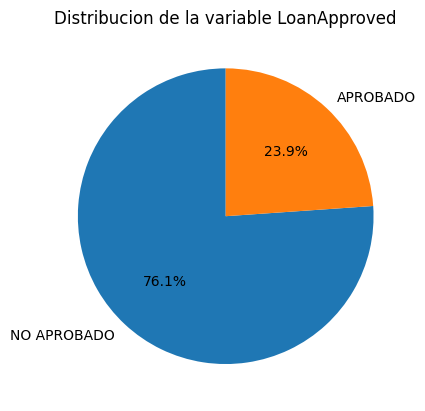

In [21]:
plt.Figure()
plt.gcf().set_facecolor('white')
plt.pie(count_LoanApprove, labels=count_LoanApprove.index, autopct='%1.1f%%', startangle=90)
plt.title("Distribucion de la variable LoanApproved")
plt.show()


DISTRIBUCION POR VARIABLE

In [22]:
object_columns = df.select_dtypes(include=['object']).columns
object_columns = object_columns.drop('LoanApproved')

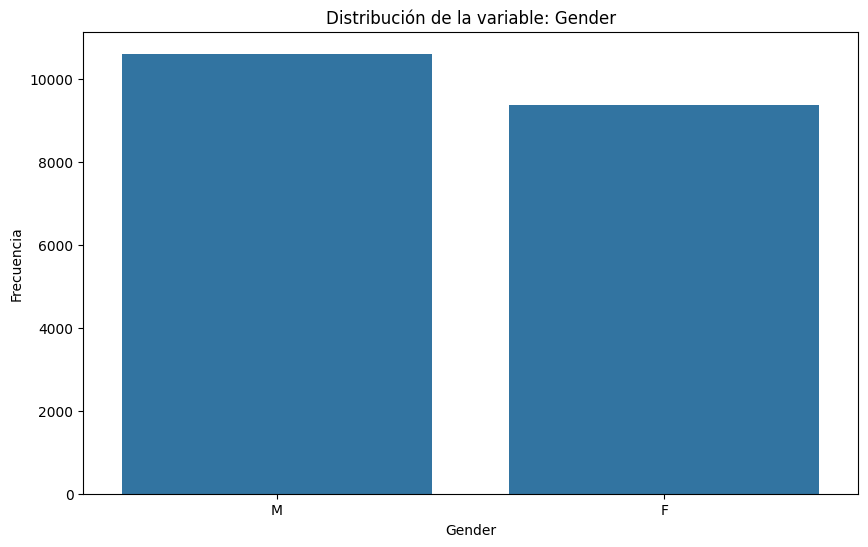

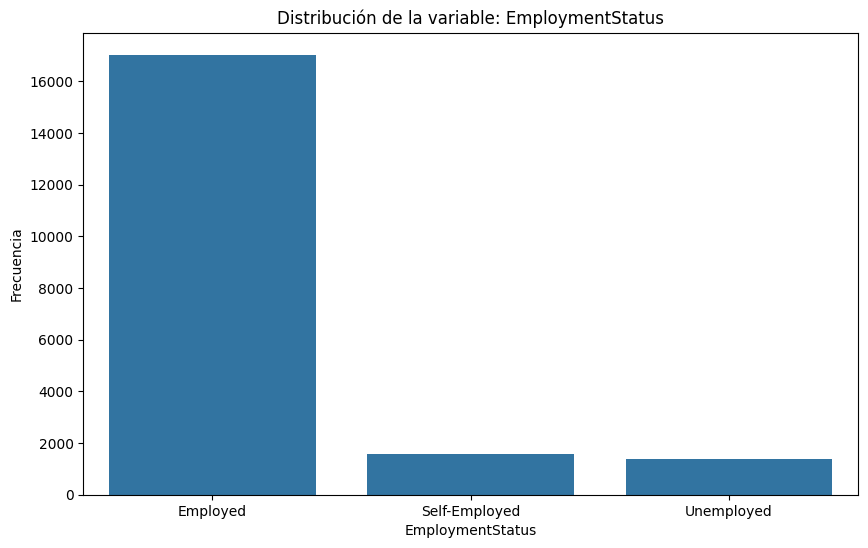

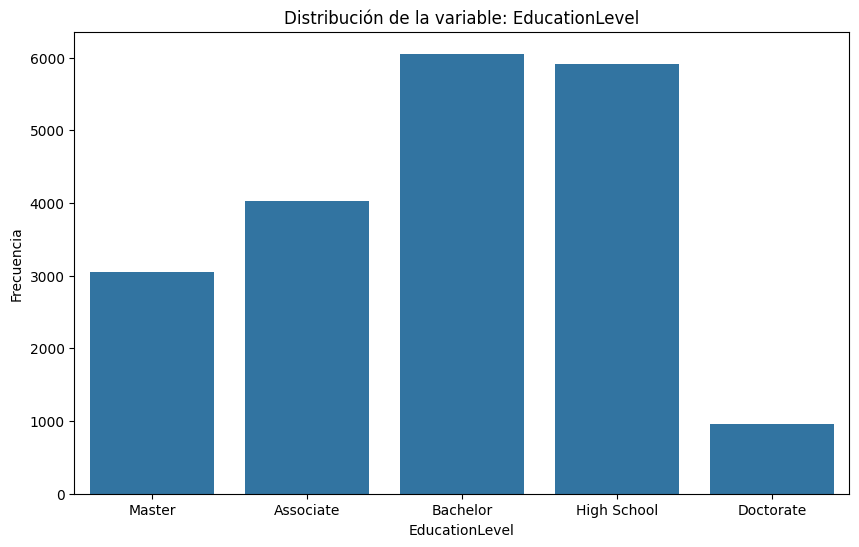

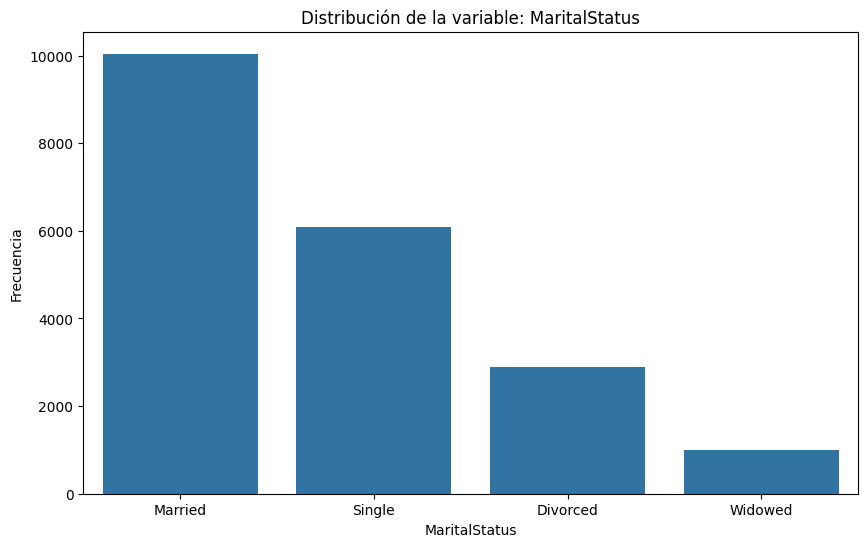

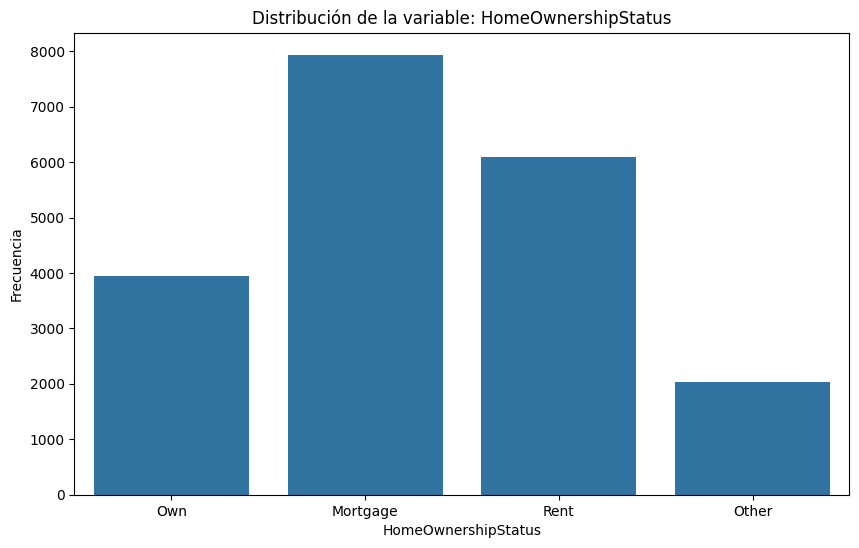

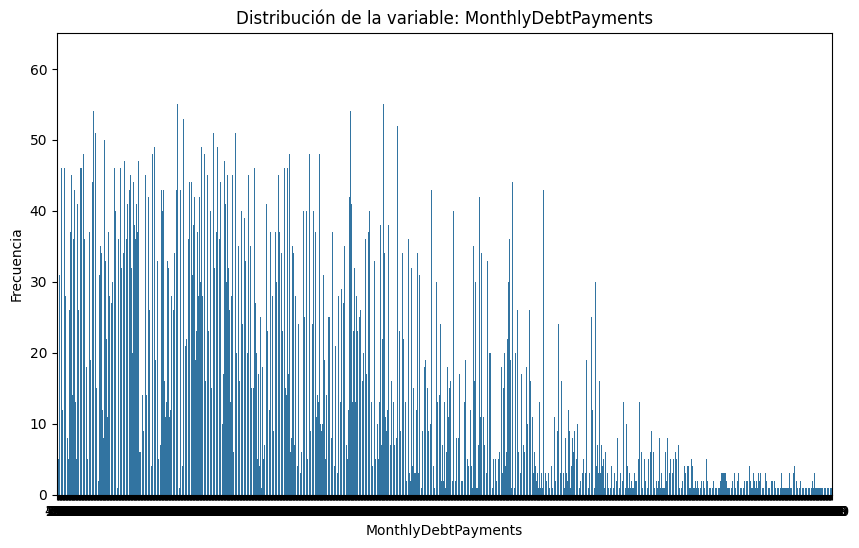

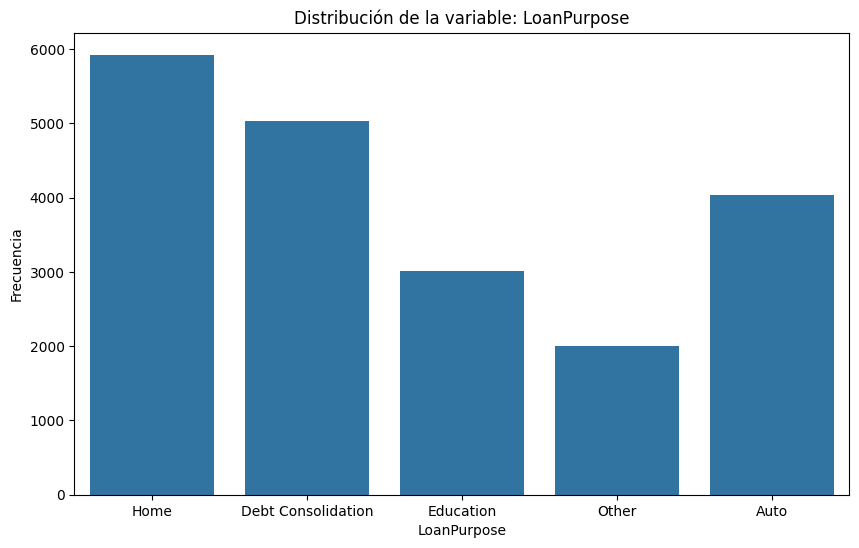

In [23]:
for column in object_columns:
    plt.figure(figsize=(10,6))
    sns.countplot(data=df, x=column)
    plt.title(f'Distribución de la variable: {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.show()

DISTRIBUCION POR VARIABLE SEGUN LA APROBACION DEL CREDITO

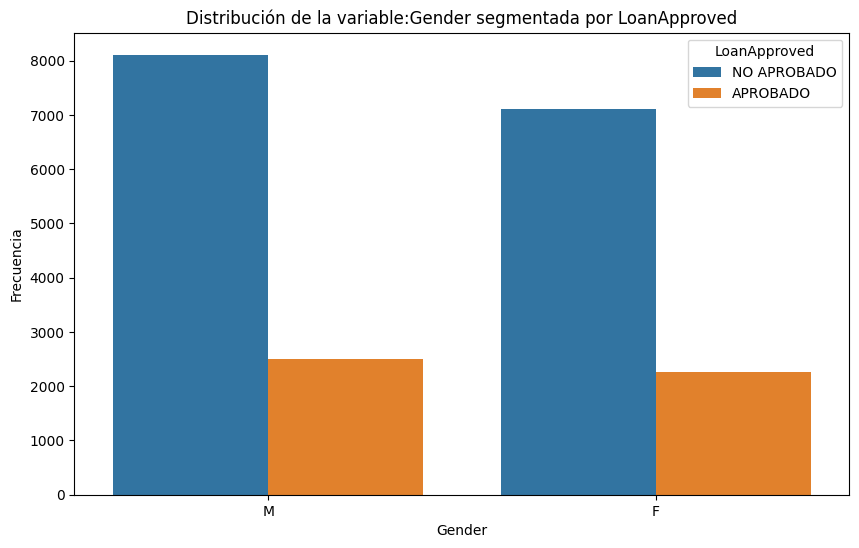

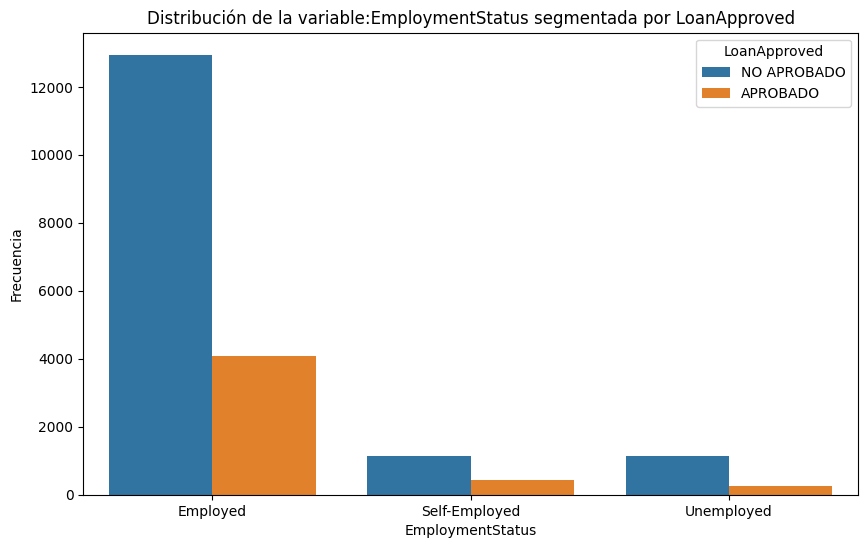

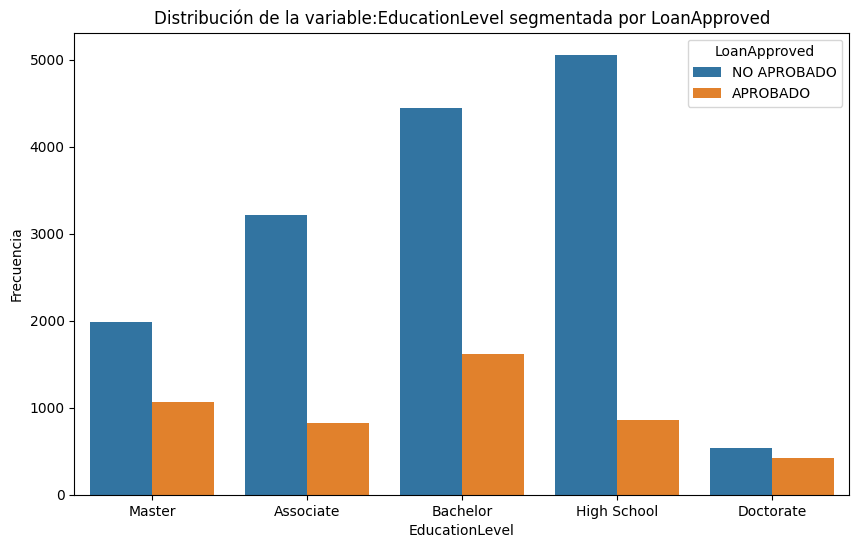

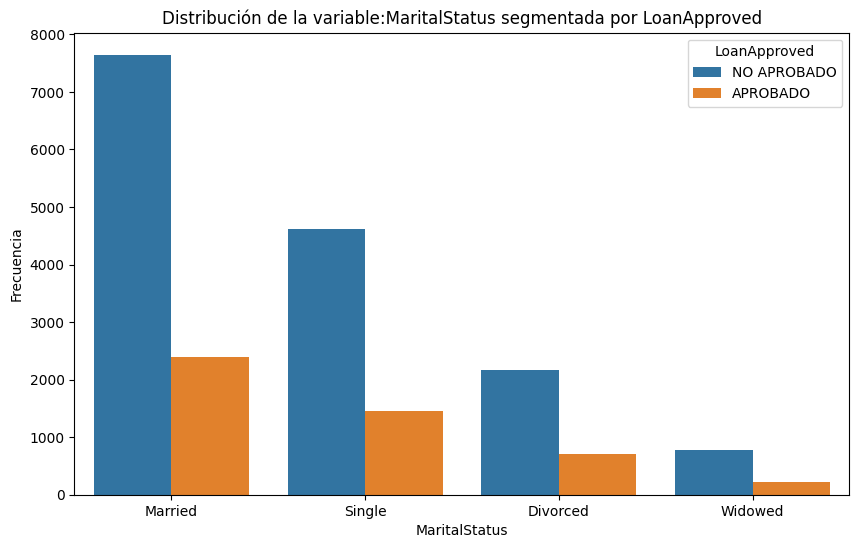

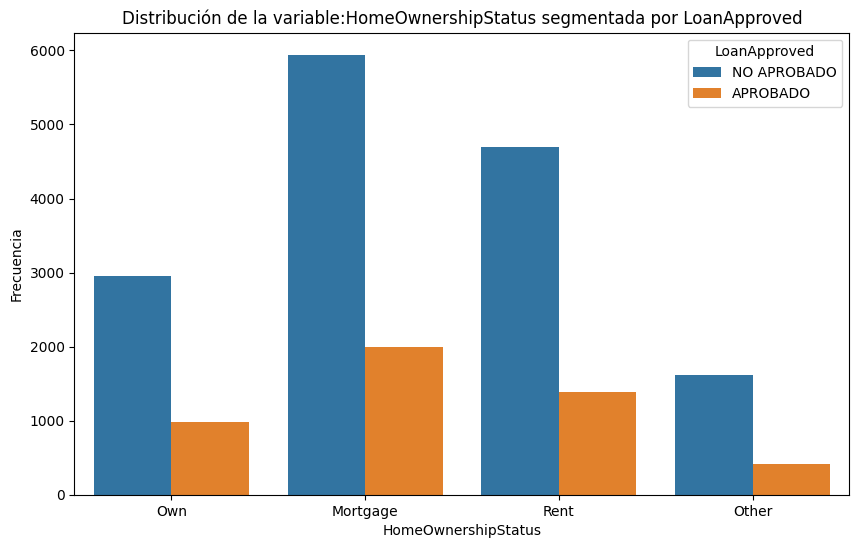

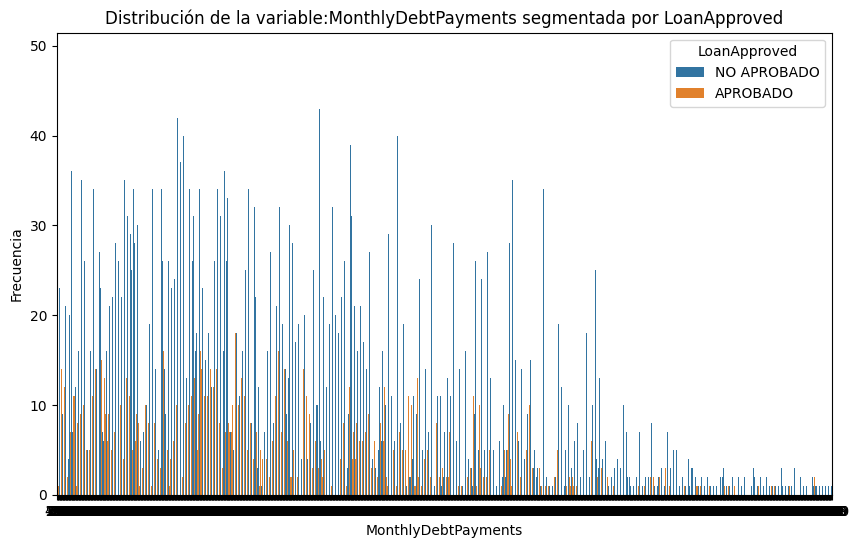

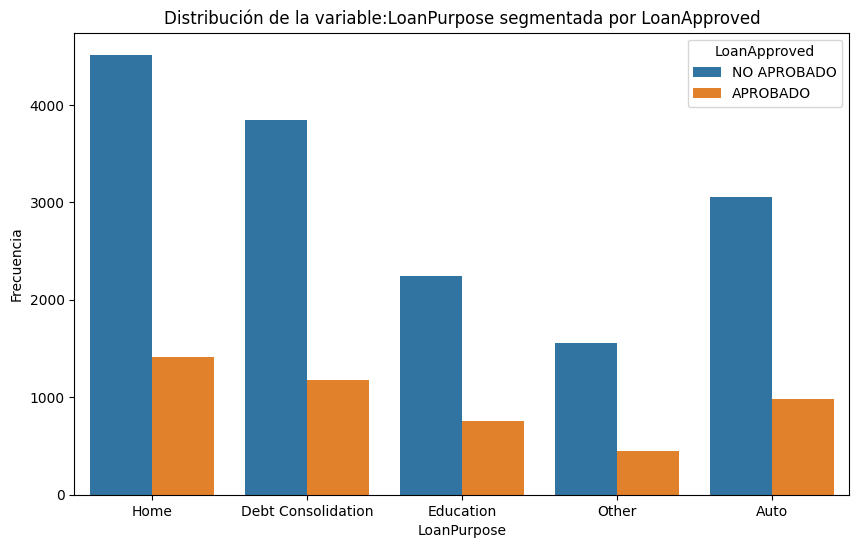

In [24]:
for column in object_columns:
    plt.figure(figsize=(10,6))
    sns.countplot(data=df, x=column, hue='LoanApproved')
    plt.title(f'Distribución de la variable:{column} segmentada por LoanApproved')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.show()

HISTORIGRAMA Y DENSIDAD EN VARIABLES NUMERICA

In [25]:
numeric_columns = df.select_dtypes(include=[np.number]).columns

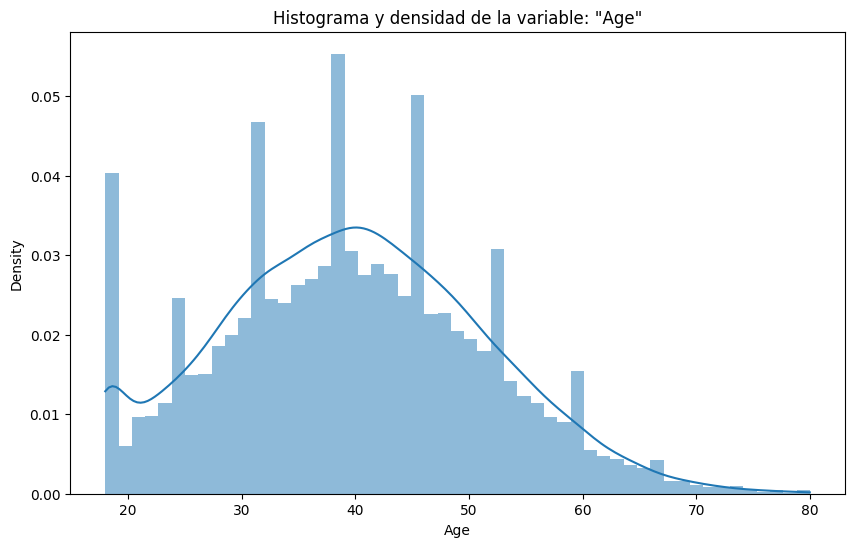

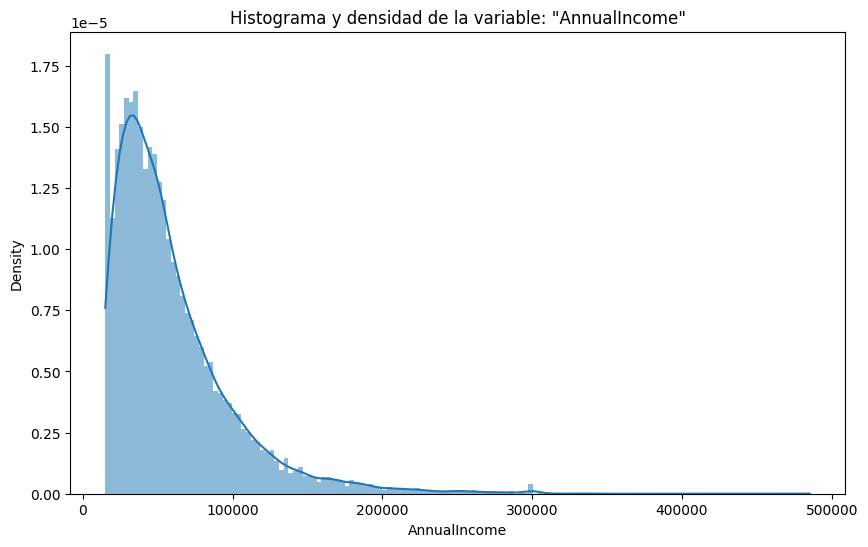

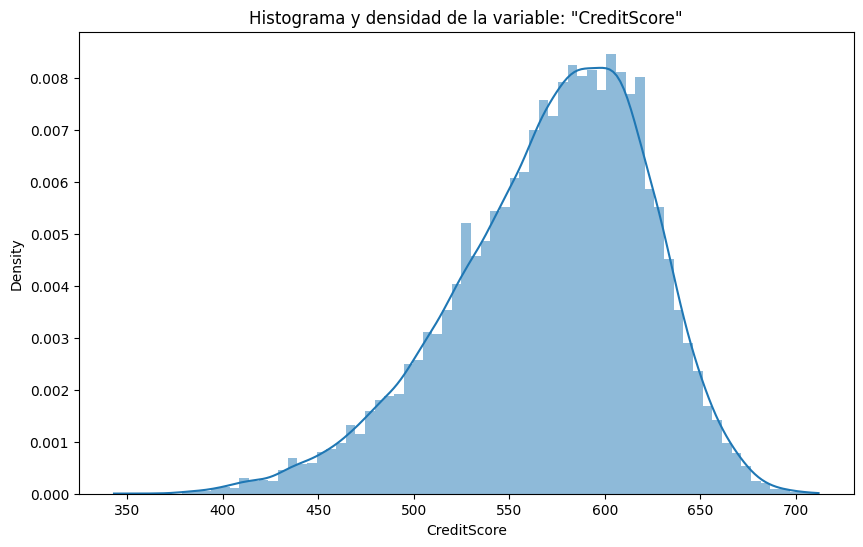

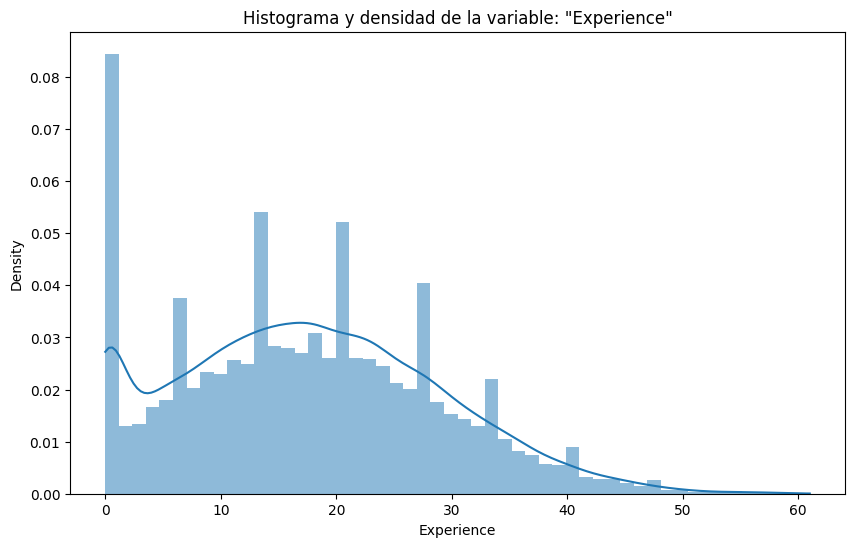

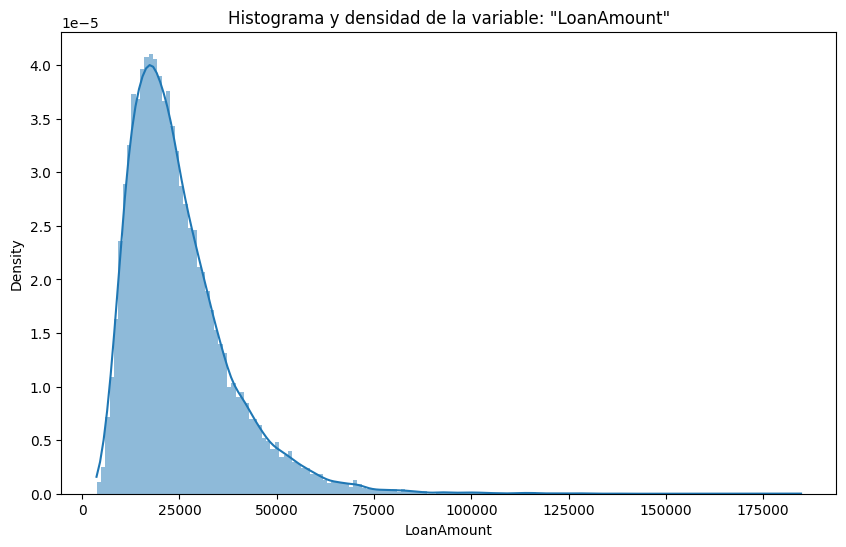

...

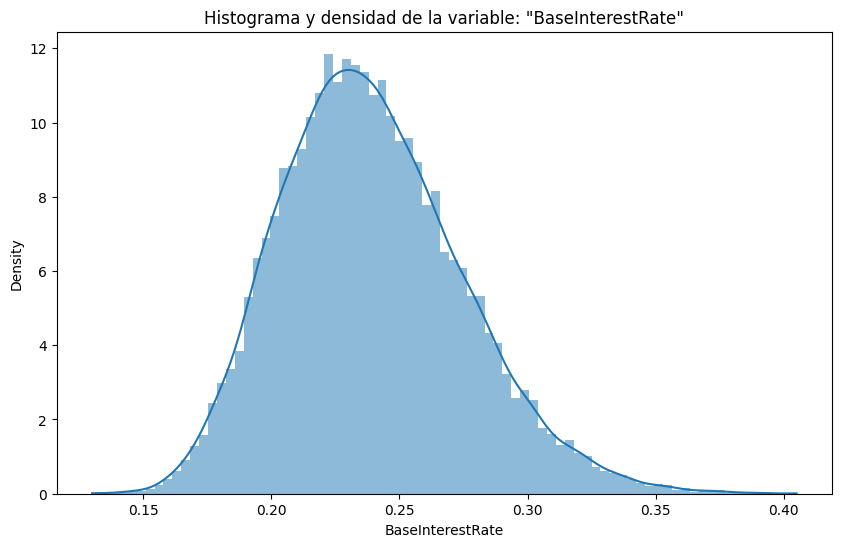

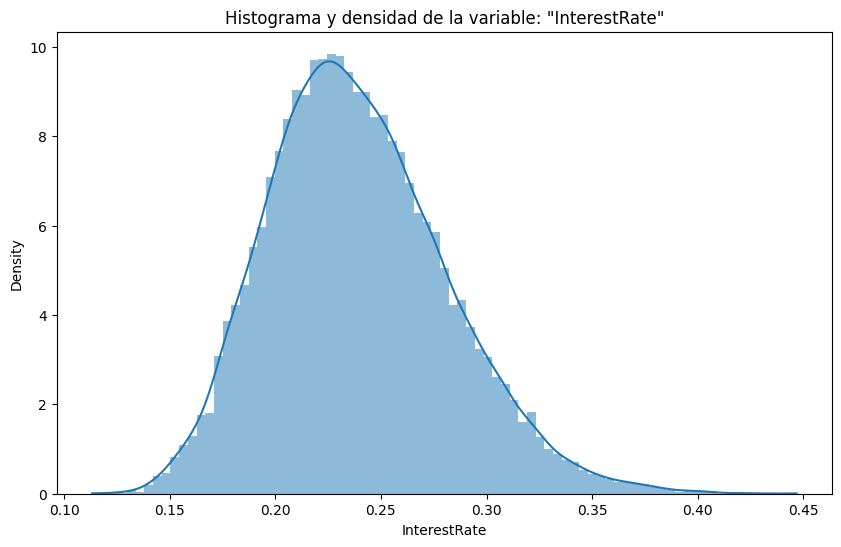

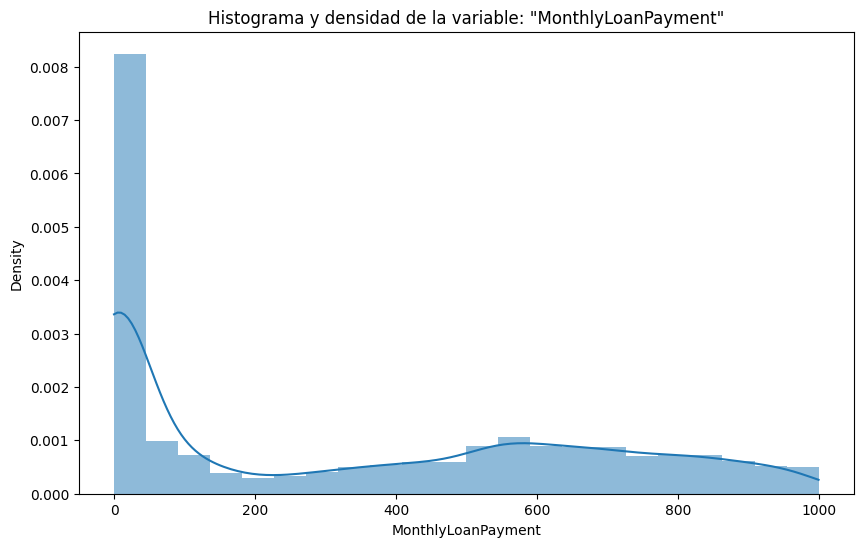

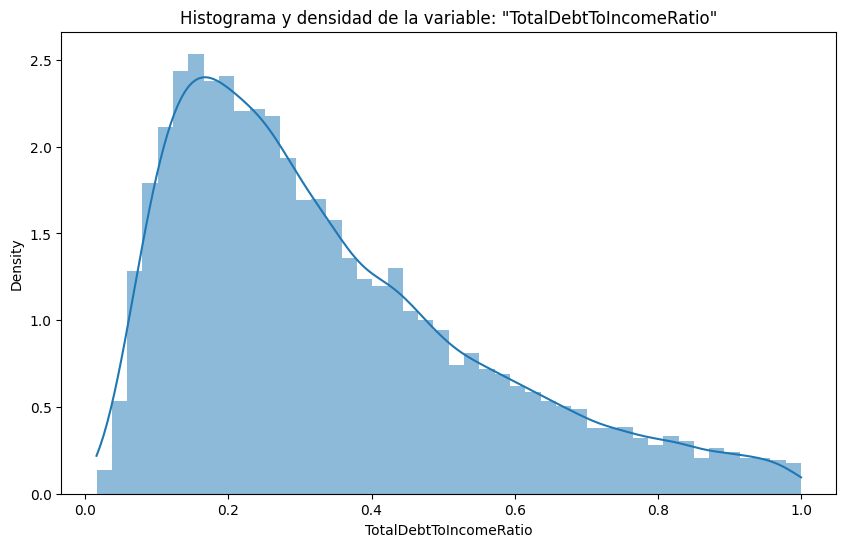

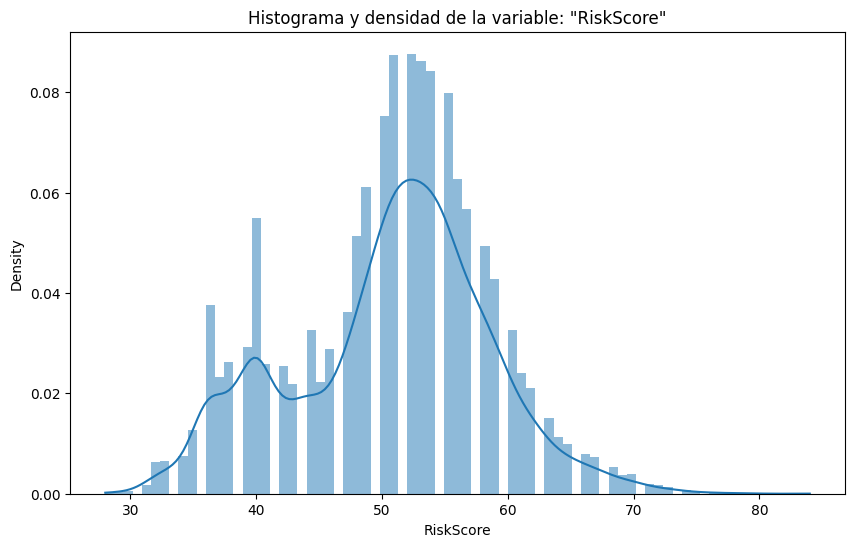

In [26]:
for col in numeric_columns:
    plt.figure(figsize=(10,6))
    sns.histplot(df[col], kde=True, stat='density', linewidth=0)
    plt.title(f'Histograma y densidad de la variable: "{col}"')
    plt.show()

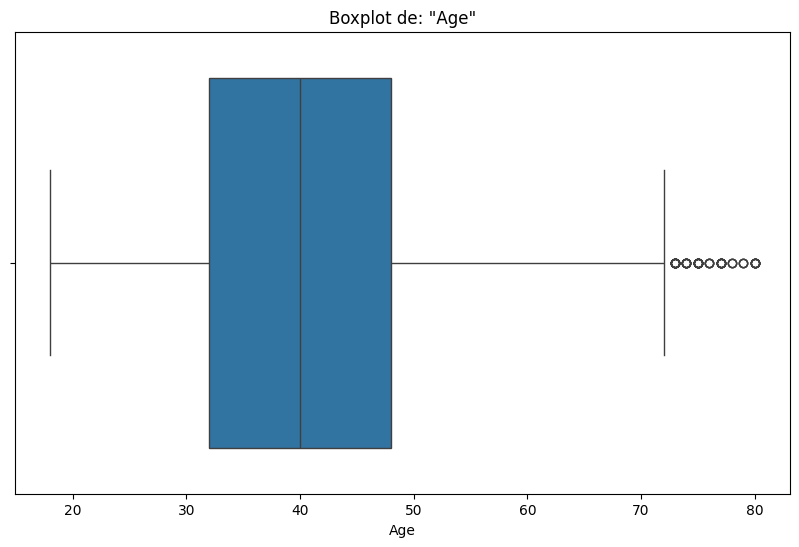

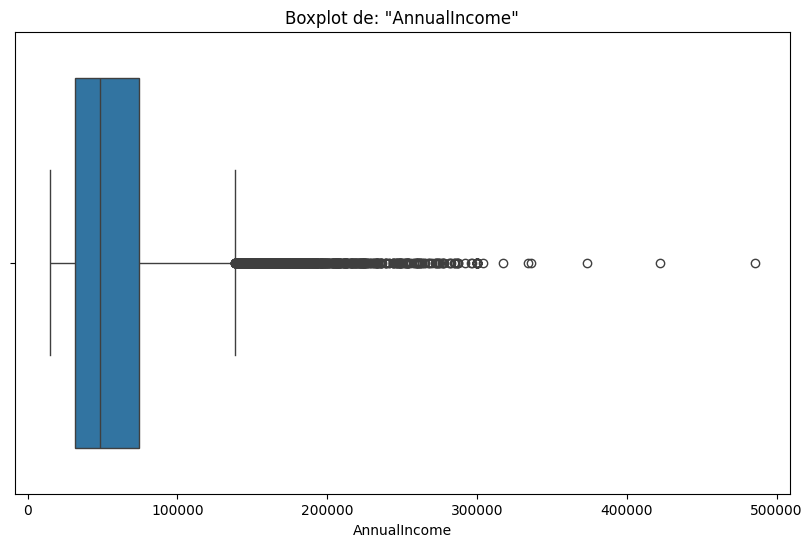

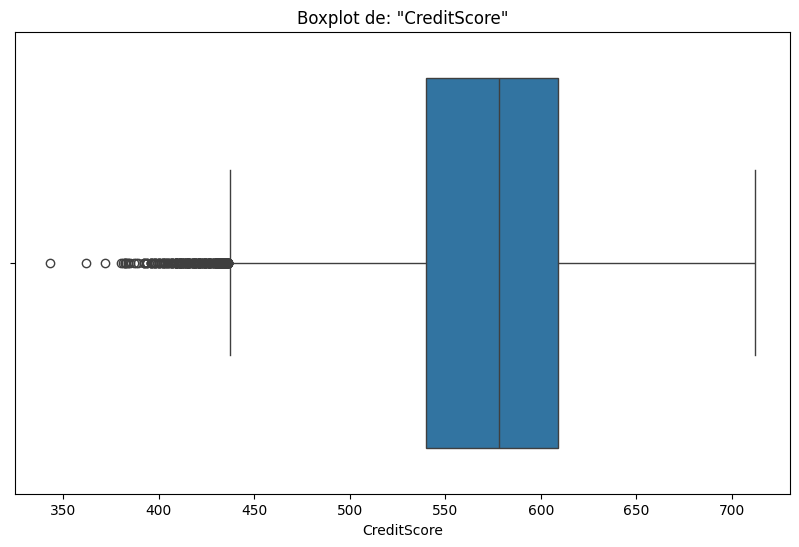

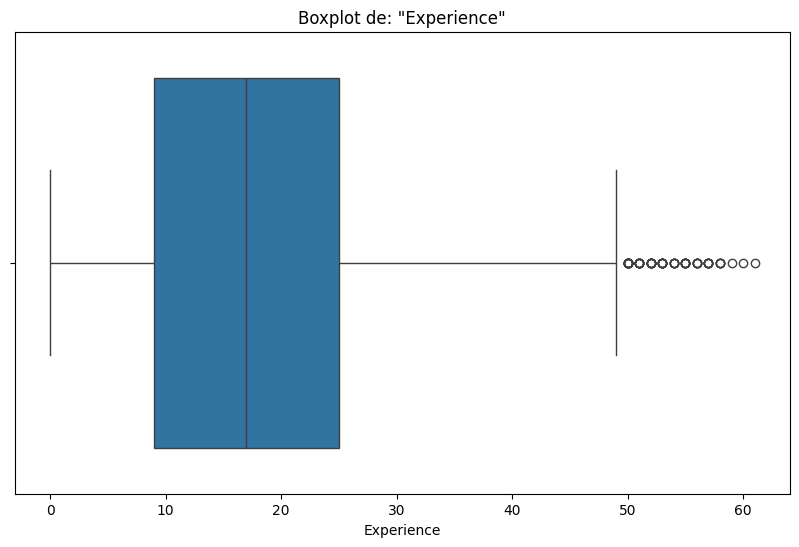

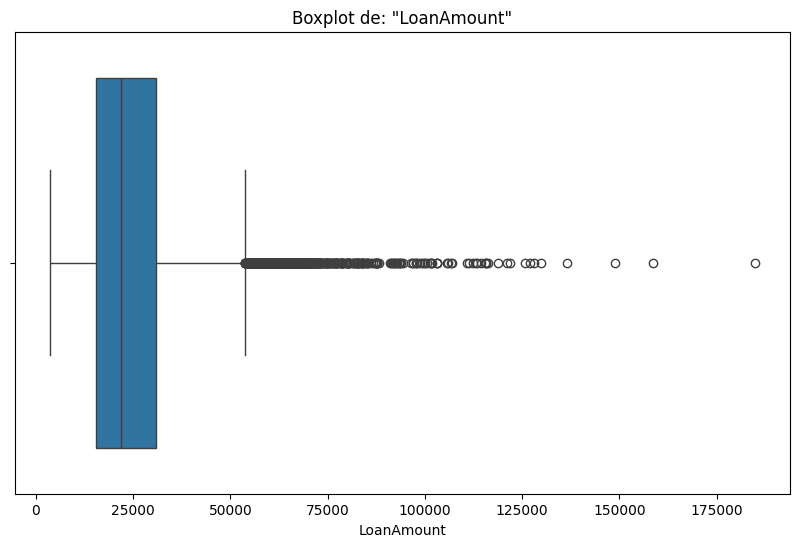

...

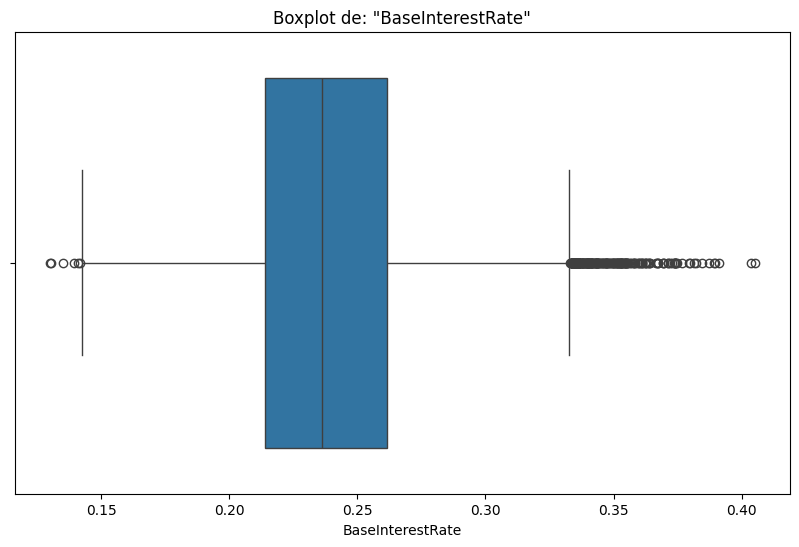

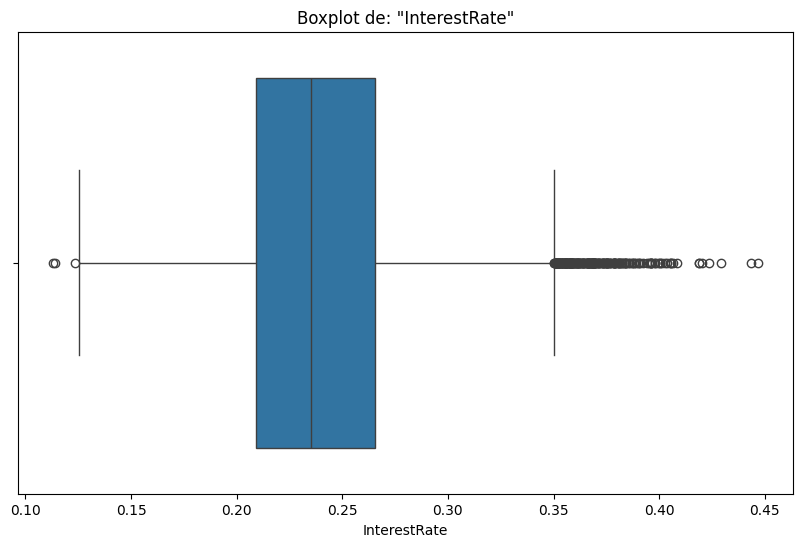

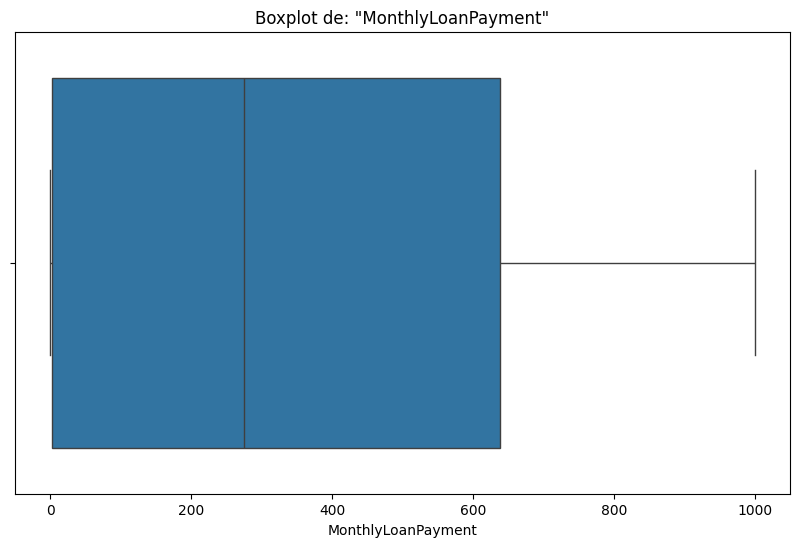

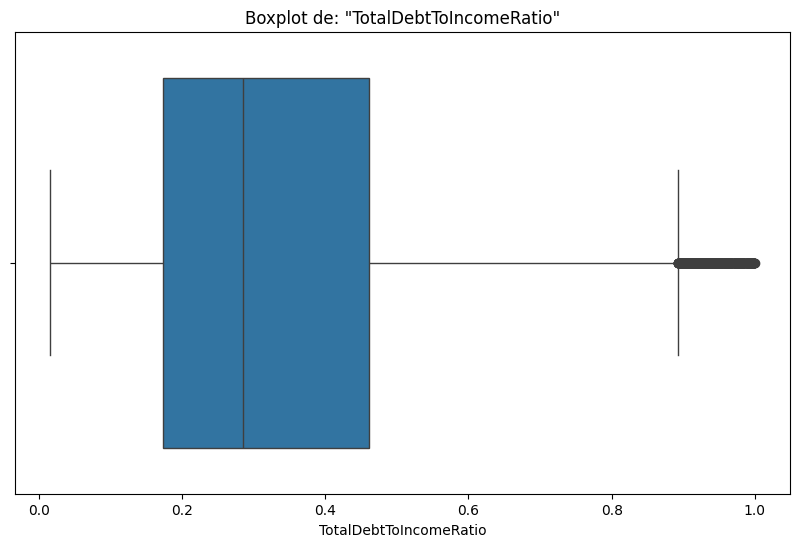

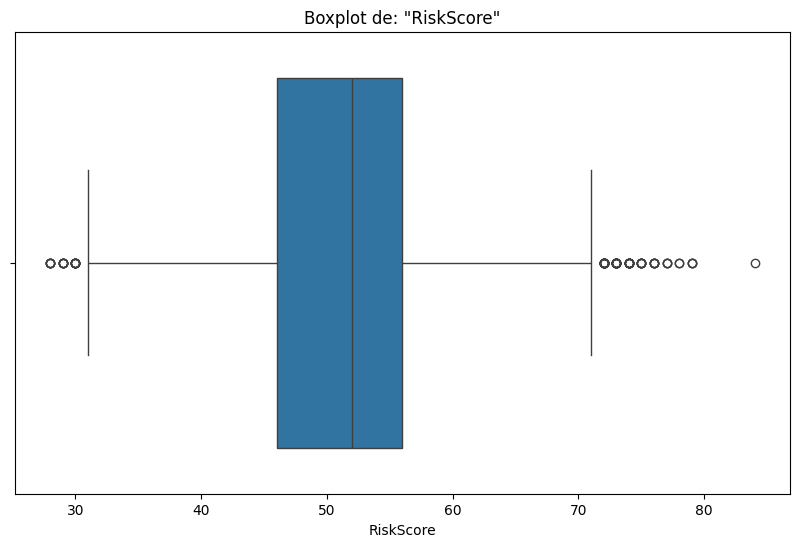

In [28]:
for col in numeric_columns:
    plt.figure(figsize=(10,6))
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot de: "{col}"')
    plt.show()

DISPERSION

In [29]:
df.columns

Index(['ApplicationDate', 'Gender', 'Age', 'AnnualIncome', 'CreditScore',
       'EmploymentStatus', 'EducationLevel', 'Experience', 'LoanAmount',
       'LoanDuration', 'MaritalStatus', 'WithChilds', 'NumberOfDependents',
       'HomeOwnershipStatus', 'MonthlyDebtPayments',
       'CreditCardUtilizationRate', 'NumberOfOpenCreditLines',
       'NumberOfCreditInquiries', 'DebtToIncomeRatio', 'BankruptcyHistory',
       'LoanPurpose', 'PreviousLoanDefaults', 'PaymentHistory',
       'LengthOfCreditHistory', 'SavingsAccountBalance',
       'CheckingAccountBalance', 'TotalAssets', 'TotalLiabilities',
       'MonthlyIncome', 'UtilityBillsPaymentHistory', 'JobTenure', 'NetWorth',
       'BaseInterestRate', 'InterestRate', 'MonthlyLoanPayment',
       'TotalDebtToIncomeRatio', 'LoanApproved', 'RiskScore'],
      dtype='object')

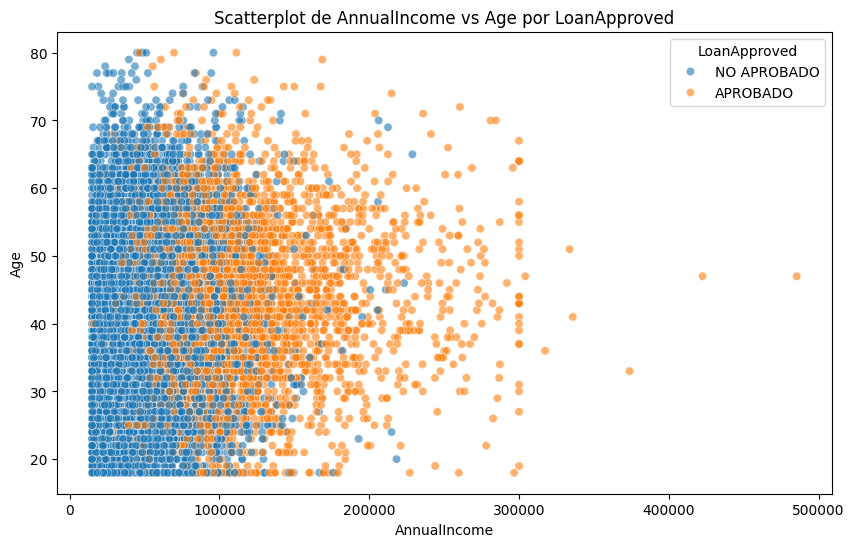

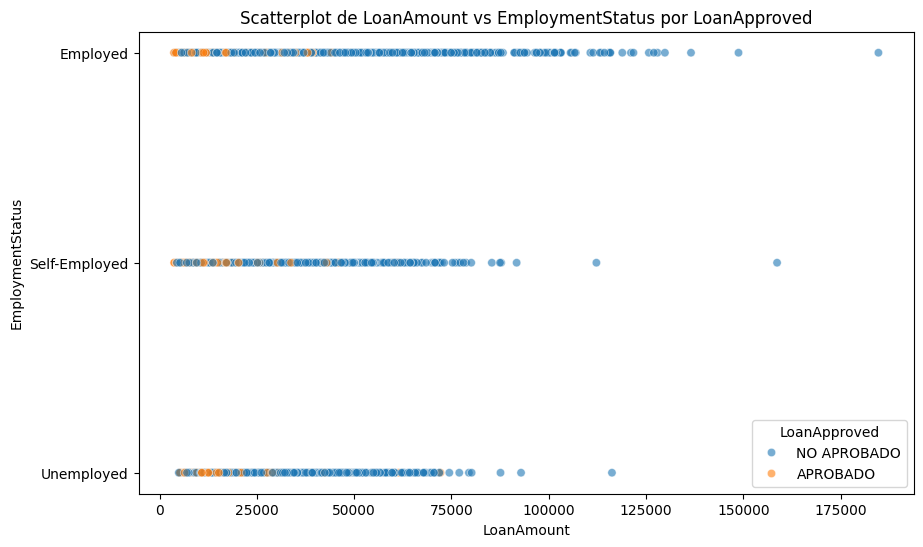

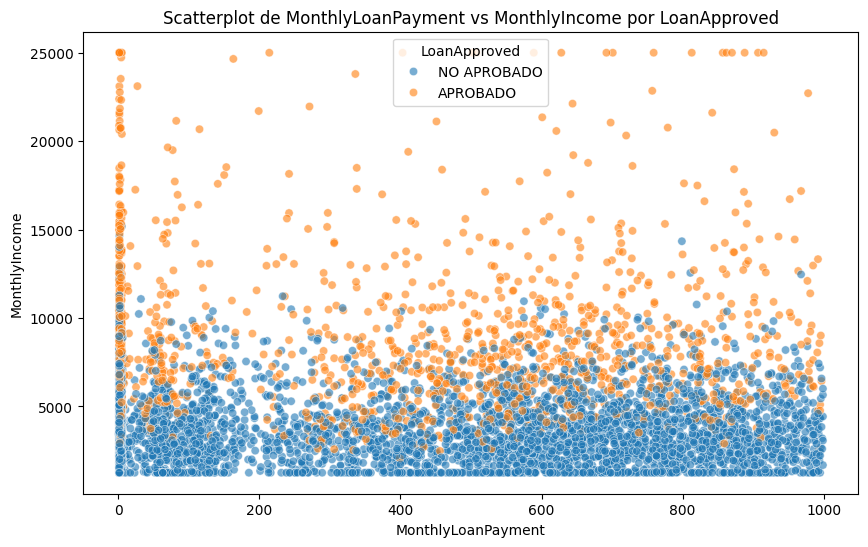

In [58]:
vars_to_compare = [("AnnualIncome","Age"), ("LoanAmount","EmploymentStatus"),("MonthlyLoanPayment","MonthlyIncome"),("PreviousLoanDefaults","BankruptcyHistory")]

for x_var, y_var in vars_to_compare:
    plt.figure(figsize=(10,6))
    sns.scatterplot(x=x_var, y = y_var, hue="LoanApproved", data=df, alpha=0.6)
    plt.title(f"Scatterplot de {x_var} vs {y_var} por LoanApproved")
    plt.show()

In [59]:
df[numeric_columns].corr(method="pearson")

,Age,AnnualIncome,CreditScore,Experience,LoanAmount,LoanDuration,NumberOfDependents,MonthlyDebtPayments,CreditCardUtilizationRate,NumberOfOpenCreditLines,...,TotalLiabilities,MonthlyIncome,UtilityBillsPaymentHistory,JobTenure,NetWorth,BaseInterestRate,InterestRate,MonthlyLoanPayment,TotalDebtToIncomeRatio,RiskScore
Age,1.000000,0.144774,0.323243,0.982980,-0.007492,-0.006992,-0.000287,0.015685,-0.001394,-0.001069,...,-0.001197,0.162267,-0.005601,-0.000773,0.014061,-0.238995,-0.202702,-0.003873,-0.119684,-0.164693
AnnualIncome,0.144774,1.000000,0.104045,0.145999,-0.004116,0.002972,-0.001244,-0.001082,-0.007935,-0.008175,...,-0.002353,0.994312,-0.012351,-0.000610,-0.004358,-0.074549,-0.063832,-0.001611,-0.611496,-0.488228
CreditScore,0.323243,0.104045,1.000000,0.327664,-0.010834,-0.000762,-0.014453,0.011153,-0.009650,-0.008780,...,-0.006722,0.116837,-0.006838,0.008069,0.001951,-0.722619,-0.598844,0.018992,-0.116921,-0.239299
Experience,0.982980,0.145999,0.327664,1.000000,-0.007921,-0.007924,0.000136,0.018629,-0.001751,-0.002143,...,-0.000449,0.163791,-0.006603,-0.000762,0.015049,-0.242871,-0.206252,-0.003329,-0.120834,-0.166830
LoanAmount,-0.007492,-0.004116,-0.010834,-0.007921,1.000000,-0.000436,-0.007005,0.021103,0.000806,0.000769,...,0.000502,-0.008148,-0.012107,0.005364,-0.003679,0.385663,0.322824,-0.145990,0.365591,0.140862
LoanDuration,-0.006992,0.002972,-0.000762,-0.007924,-0.000436,1.000000,-0.001301,0.000068,-0.006160,0.001489,...,0.003668,0.003343,-0.010105,0.003635,-0.008779,0.579215,0.487994,0.070085,-0.166725,0.055725
NumberOfDependents,-0.000287,-0.001244,-0.014453,0.000136,-0.007005,-0.001301,1.000000,-0.002396,0.011544,0.006033,...,0.009942,0.001243,0.008735,0.010910,-0.008423,0.006977,0.006749,-0.001831,-0.006430,0.001555
MonthlyDebtPayments,0.015685,-0.001082,0.011153,0.018629,0.021103,0.000068,-0.002396,1.000000,0.005420,0.006280,...,-0.004211,-0.010366,0.001638,0.005863,0.004430,0.000010,0.003895,-0.013492,0.211988,0.037829
CreditCardUtilizationRate,-0.001394,-0.007935,-0.009650,-0.001751,0.000806,-0.006160,0.011544,0.005420,1.000000,0.001491,...,-0.007778,-0.003231,0.013040,-0.006979,-0.003506,0.003668,0.001030,-0.008580,0.012791,0.107208
NumberOfOpenCreditLines,-0.001069,-0.008175,-0.008780,-0.002143,0.000769,0.001489,0.006033,0.006280,0.001491,1.000000,...,-0.008406,-0.027415,-0.010497,0.007298,-0.002013,0.007457,0.008090,-0.006650,0.011927,0.007804


In [60]:
sns.pairplot(df, diag_kind="kde")
plt.suptitle("Pairplot", y=1.02)
plt.show()

In [71]:
from fitter import Fitter

In [72]:
aprobados = df[df["LoanApproved"]=="APROBADO"]["Age"]

In [73]:
no_aprobados = df[df["LoanApproved"]=="NO APROBADO"]["Age"]

2024-09-21 20:24:04.965 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted expon distribution with error=0.047711)
2024-09-21 20:24:04.965 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted uniform distribution with error=0.042154)
2024-09-21 20:24:04.968 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted norm distribution with error=0.026647)
2024-09-21 20:24:04.972 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted lognorm distribution with error=0.026662)
2024-09-21 20:24:05.004 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted gamma distribution with error=0.026663)


,sumsquare_error,aic,bic,kl_div,ks_statistic,ks_pvalue
norm,0.026647,967.469713,980.414105,inf,0.025953,0.003139
lognorm,0.026662,958.940037,978.356624,inf,0.025877,0.003259
gamma,0.026663,958.794503,978.211091,inf,0.026086,0.002938
uniform,0.042154,829.426877,842.371269,inf,0.282474,0.000000
expon,0.047711,896.419584,909.363976,inf,0.280656,0.000000


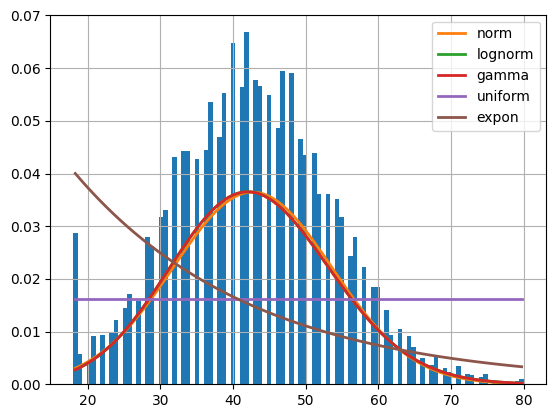

In [74]:
f = Fitter(aprobados, distributions=["norm","uniform","lognorm","gamma", "expon"])
f.fit()
f.summary()

2024-09-21 20:25:09.073 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted uniform distribution with error=0.039848)
2024-09-21 20:25:09.078 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted expon distribution with error=0.038478)
2024-09-21 20:25:09.077 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted norm distribution with error=0.027757)
2024-09-21 20:25:09.167 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted gamma distribution with error=0.027902)
2024-09-21 20:25:09.916 | INFO     | fitter.fitter:_fit_single_distribution:333 - Fitted lognorm distribution with error=0.027871)


,sumsquare_error,aic,bic,kl_div,ks_statistic,ks_pvalue
norm,0.027757,989.911304,1005.172035,inf,0.037231,9.120950e-19
lognorm,0.027871,959.601520,982.492616,inf,0.029606,5.041310e-12
gamma,0.027902,956.678040,979.569137,inf,0.032462,2.278588e-14
expon,0.038478,908.907571,924.168302,inf,0.211237,0.000000e+00
uniform,0.039848,829.426877,844.687608,inf,0.323132,0.000000e+00


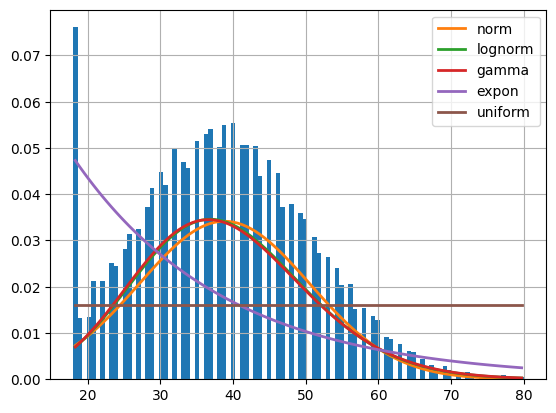

In [76]:
f = Fitter(no_aprobados, distributions=["norm","uniform","lognorm","gamma", "expon"])
f.fit()
f.summary()